In [17]:
import os, sys, git, time, io, ntpath, tracemalloc, sqlite3, pandas as pd, numpy as np
from pandas.api.types import CategoricalDtype
import sklearn
from scripts.log_processing.plotting import *

from scripts.log_processing.mazeAndPcsPlotter import *
import xml.etree.ElementTree as ET


# DO NOT IMPORT IN REAL SCRIPT:
import matplotlib.pyplot as plt
from ipywidgets import widgets
from IPython.display import display
from os import path
import matplotlib.collections
import matplotlib.collections as mcoll
from matplotlib.patches import Circle, Wedge, Polygon
from matplotlib.collections import PatchCollection
import matplotlib.path as mpath

%matplotlib widget

In [49]:
def plot_maze(mazes_file,pcs_file):
    maze_folder = 'experiments/mazes/ReplayTest'
    pcs_folder = 'experiments/pc_layers/ReplayTest'
    # Plots the maze and Place Cells
    name = mazes_file +": " + pcs_file
    maze_file = os.path.join(maze_folder, mazes_file+'.xml')
    walls, feeders, start_positions = parse_maze(maze_file)
    pc_file = os.path.join(pcs_folder, pcs_file+'.csv')
    cells = parse_all_cells(pc_file)
    fig, ax = plt.subplots(figsize=(8,8))
    x = walls.loc[:, walls.columns[::2]]
    y = walls.loc[:, walls.columns[1::2]]
    
    colors = matplotlib.colors.LinearSegmentedColormap.from_list("", ['#69c83e',"#fee193","#ff7362"])
    start_color = 'green'
    end_color = 'red'
    
    # Defines map for labels
    my_labels = {'sc' : 'Stongest Connection',
                 'gl' : 'Goal Location',
                 'sp' : 'Starting Locations',
                 'pc' : 'Place Cells'}

    
    for i in range(len(walls)):
        ax.plot(x.iloc[i,:], y.iloc[i,:], color='black', alpha=1.0,linewidth=1.75,zorder=999)
    x = feeders['x']
    y = feeders['y']
    
    for i in range(len(x)):
        ax.plot(x[i],y[i],color=end_color, marker='o',linestyle='None',label=my_labels['gl'],markersize=10,zorder=1001)
        my_labels['gl']= '_nolegend_'
    
    x = start_positions['x']
    y = start_positions['y']
    for i in range(len(x)):
        ax.plot(x[i],y[i],color=start_color, marker='o',linestyle='None', label=my_labels['sp'],markersize=10,zorder=1001)
        my_labels['sp']= '_nolegend_'

    # Adds Place Cells
    x = cells['x']
    y = cells['y']
    r = cells['r']
    xy = tuple(zip(x,y))
    pcs = []
    i = 0
    for c in xy:
        pcs.append(Circle(c,r[i], facecolor='blue',edgecolor = "black"))
        i+=1
    pcs = p = PatchCollection(pcs, edgecolor='r',alpha=0.1)
    
    ax.add_collection(pcs)
   

    

    tit = fig.suptitle(name, fontsize=14)
    ax.set_aspect(1)
    plt.tight_layout()
    
    
    # lg = plt.legend(bbox_to_anchor=(-.8, 1.0), loc='upper left', fontsize=10)
    
    # plt.show()

    return fig



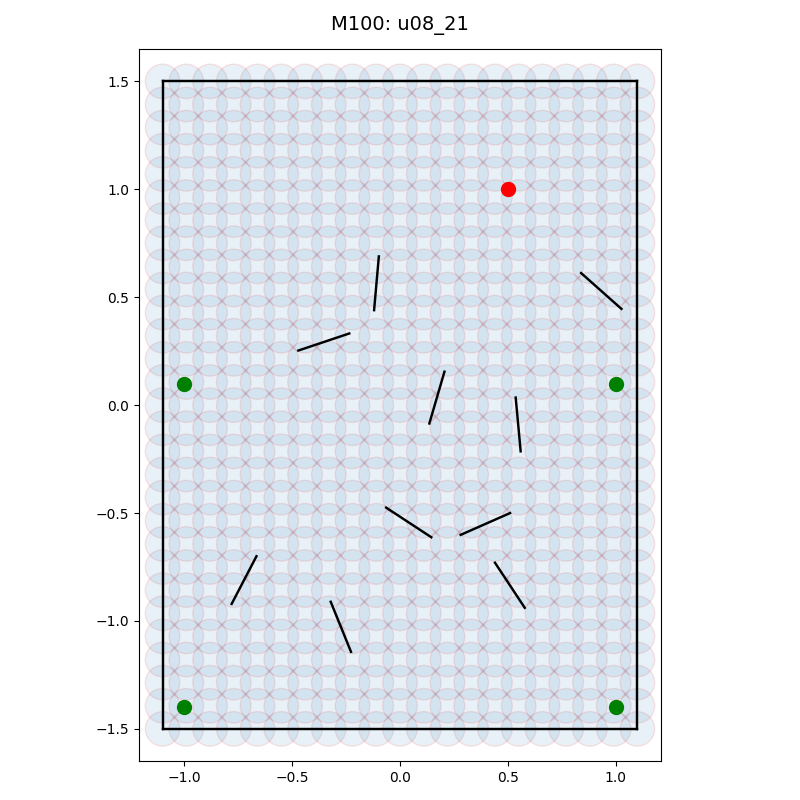

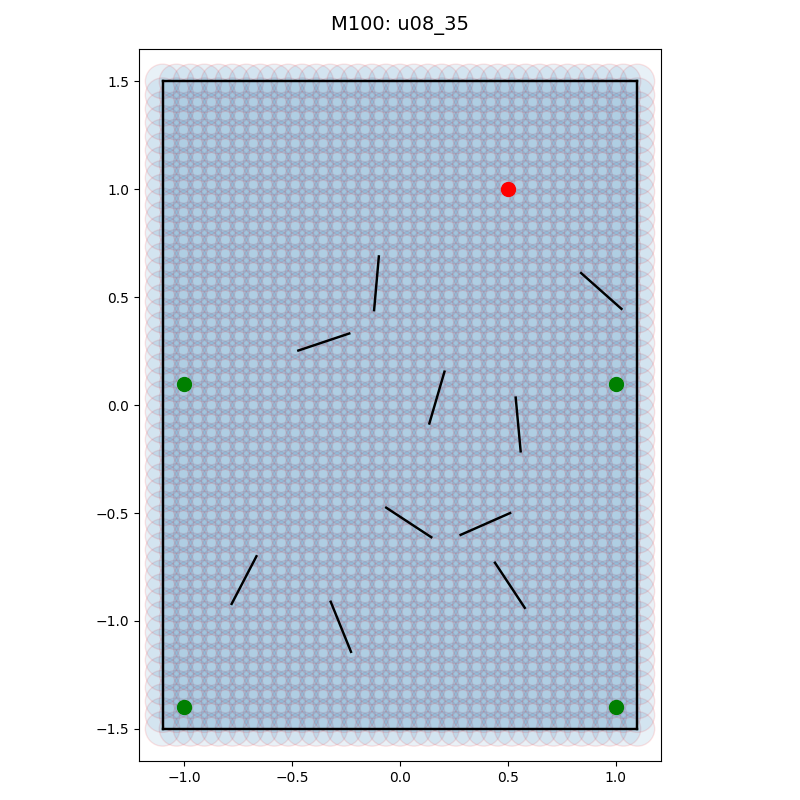

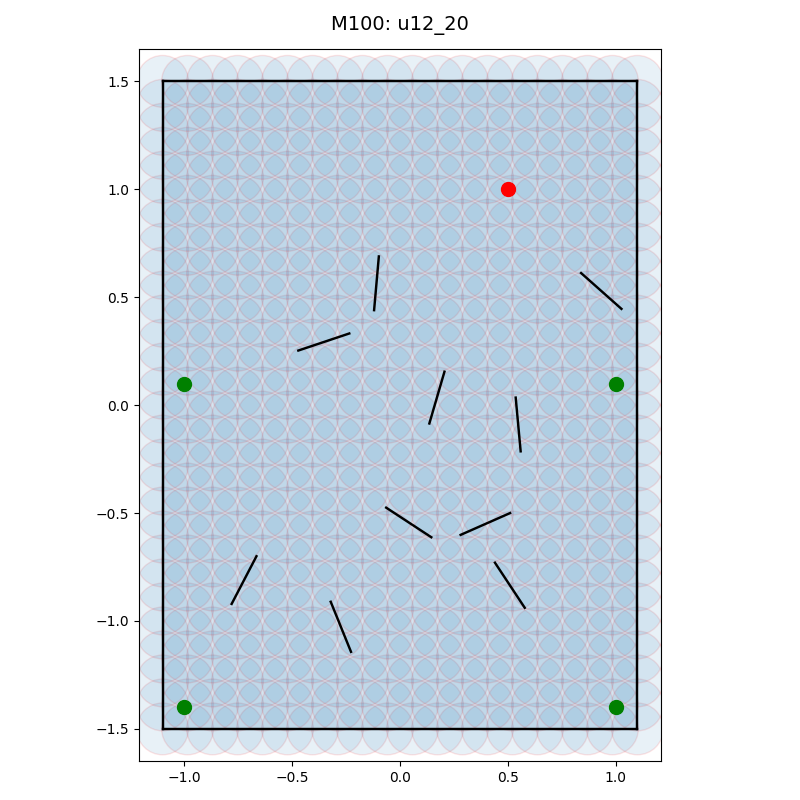

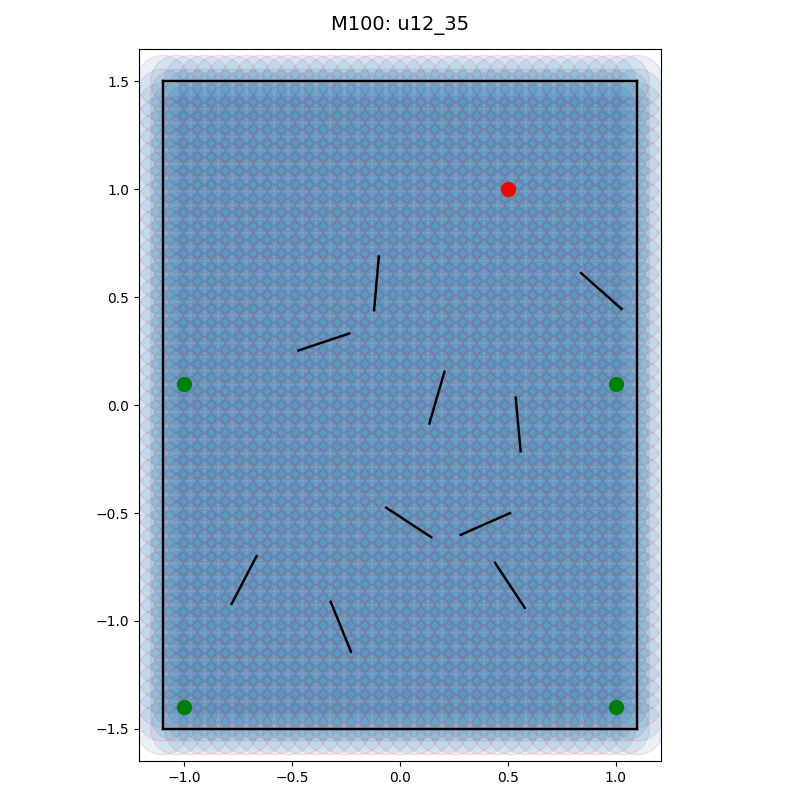

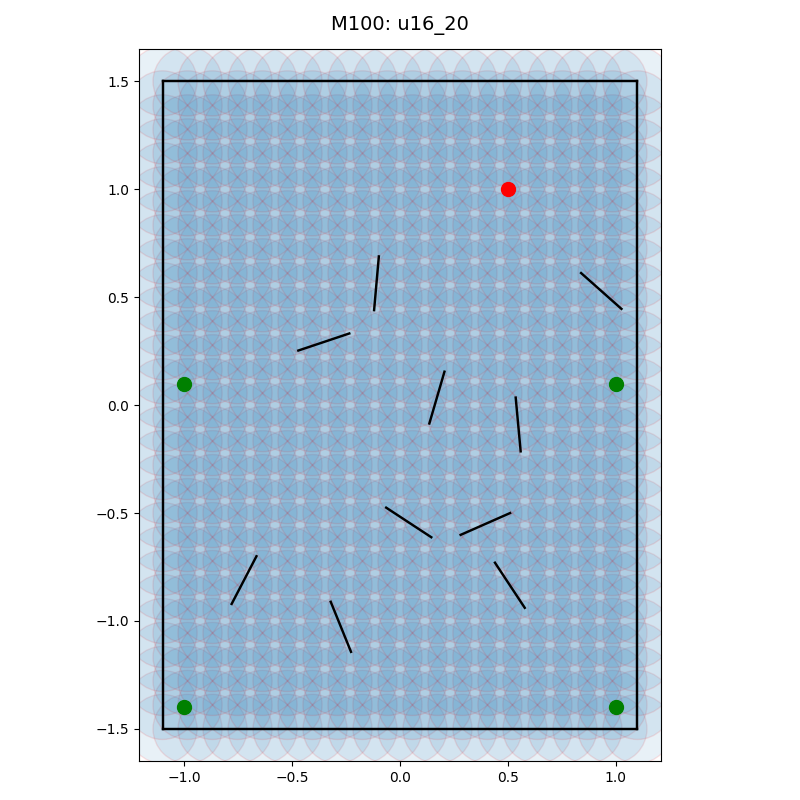

...

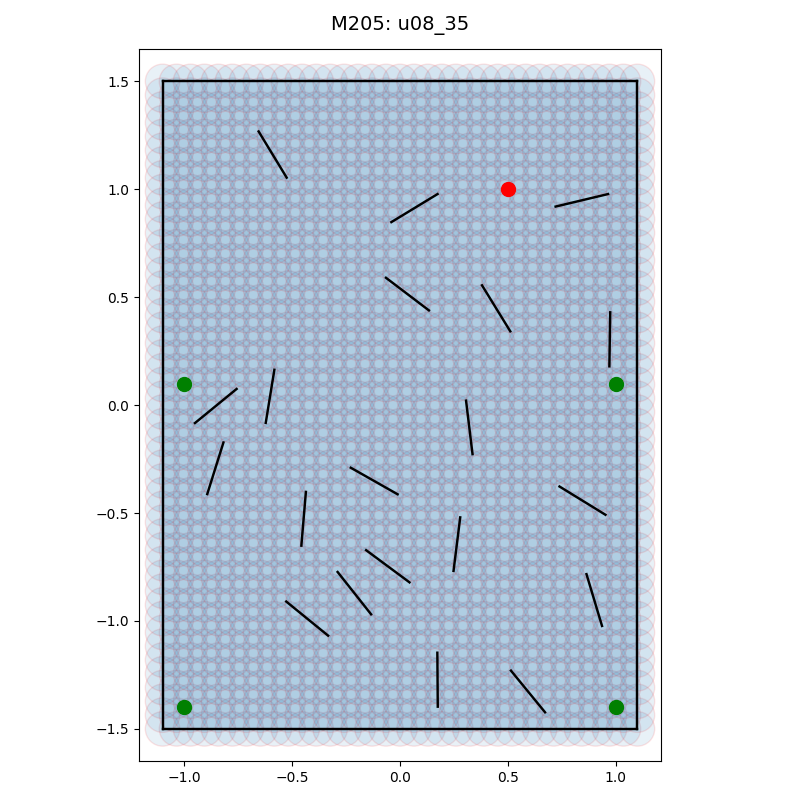

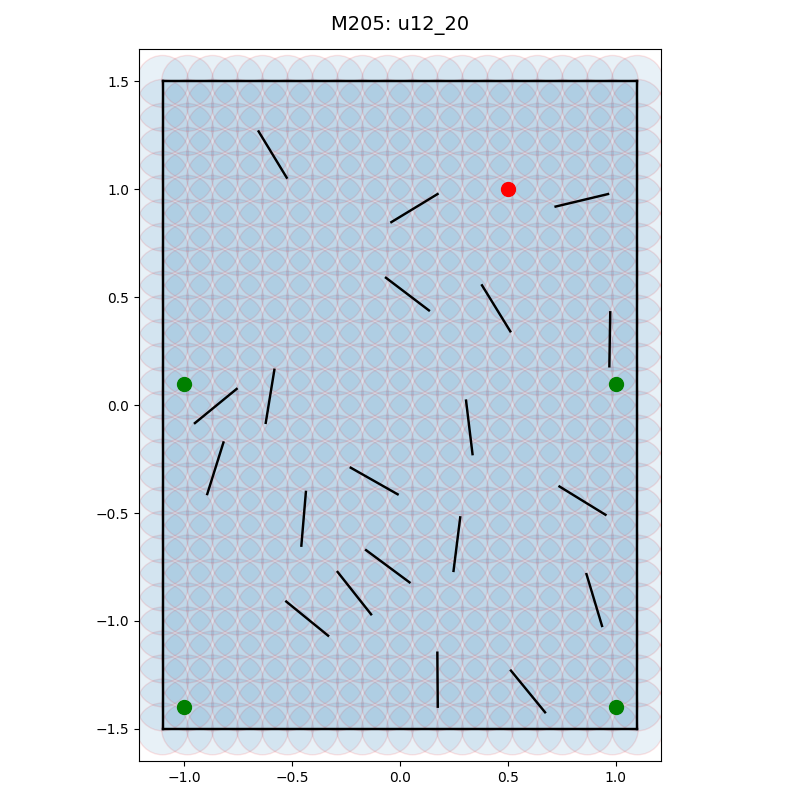

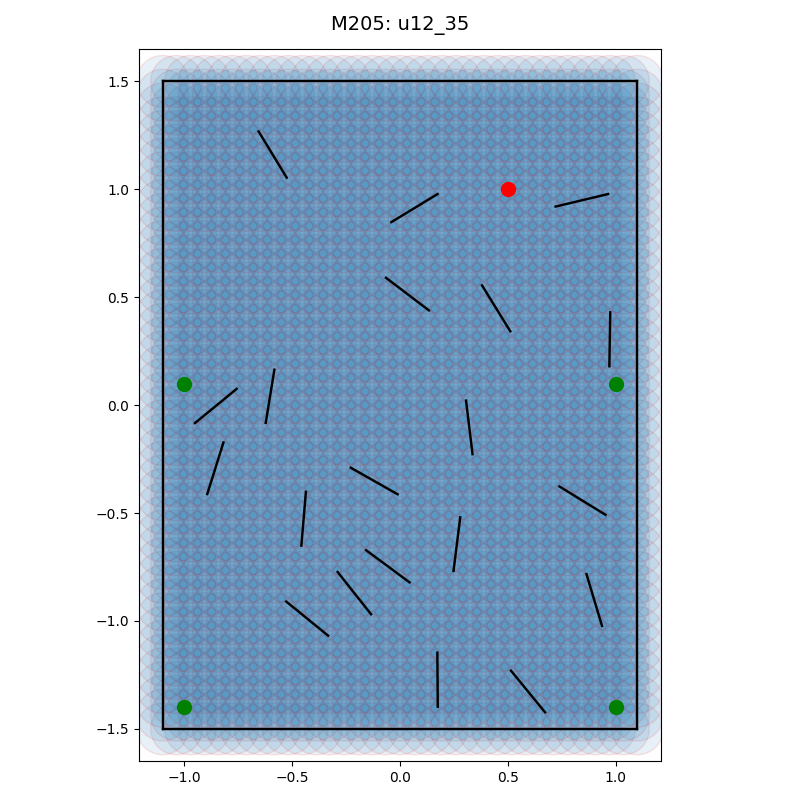

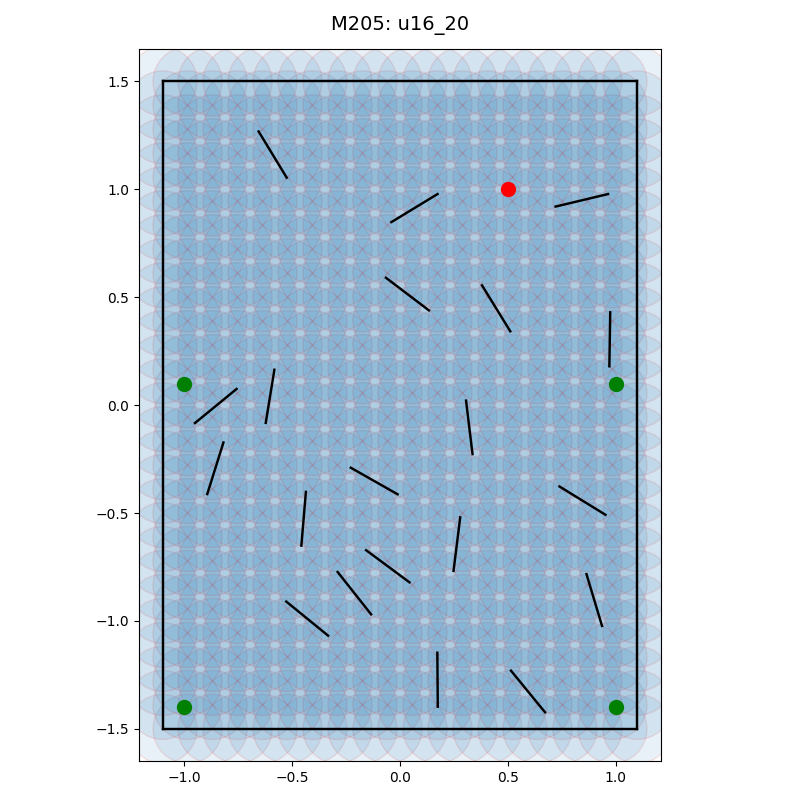

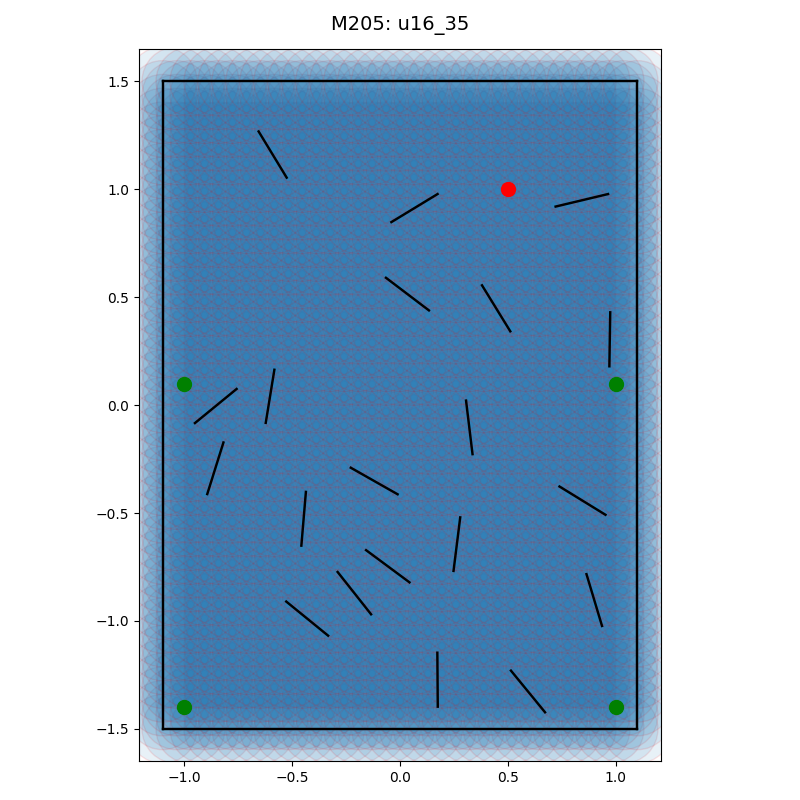

In [54]:
mazes = ['M100','M105','M200','M205']
pcs = ['u08_21','u08_35','u12_20','u12_35','u16_20','u16_35']
for m in mazes:
    for p in pcs:
        plot_maze(m,p).savefig('PresentationFigs/MazesandPCS/'+m+p+'.png')
        
